In [1]:
import numpy as np
import tensorflow as tf
import keras
import cv2
from keras.layers import MaxPool2D,Conv2D,UpSampling2D,Input,Dropout
from keras.models import Sequential
from tensorflow.keras.utils import img_to_array
import os
from tqdm import tqdm
import re
import matplotlib.pyplot as plt

In [2]:
# to get the files in proper order
def sorted_alphanumeric(data):  
    convert = lambda text: int(text) if text.isdigit() else text.lower()
    alphanum_key = lambda key: [convert(c) for c in re.split('([0-9]+)',key)]
    return sorted(data,key = alphanum_key)
# defining the size of the image
SIZE = 160
color_img = []
path = '../DATA/landscapeImages/color'
files = os.listdir(path)
files = sorted_alphanumeric(files)
for i in tqdm(files):    
      
    img = cv2.imread(path + '/'+i,1)
    # open cv reads images in BGR format so we have to convert it to RGB
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    #resizing image
    img = cv2.resize(img, (SIZE, SIZE))
    img = img.astype('float32') / 255.0
    color_img.append(img_to_array(img))


gray_img = []
path = '../DATA/landscapeImages/gray'
files = os.listdir(path)
files = sorted_alphanumeric(files)
for i in tqdm(files):
    img = cv2.imread(path + '/'+i,1)

    #resizing image
    img = cv2.resize(img, (SIZE, SIZE))
    img = img.astype('float32') / 255.0
    gray_img.append(img_to_array(img))


100%|██████████| 7129/7129 [00:05<00:00, 1275.67it/s]


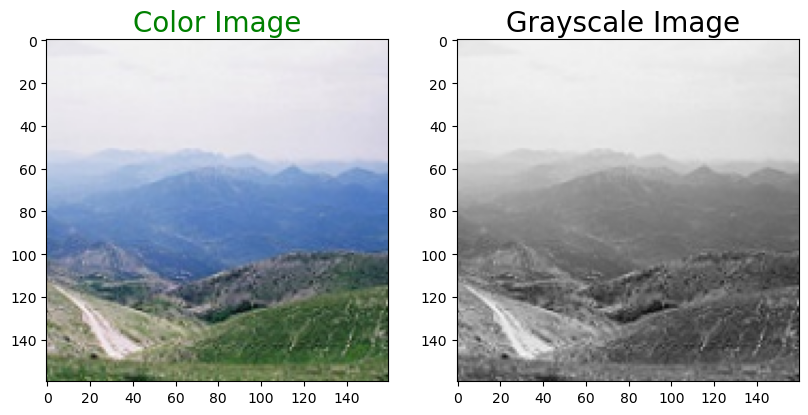

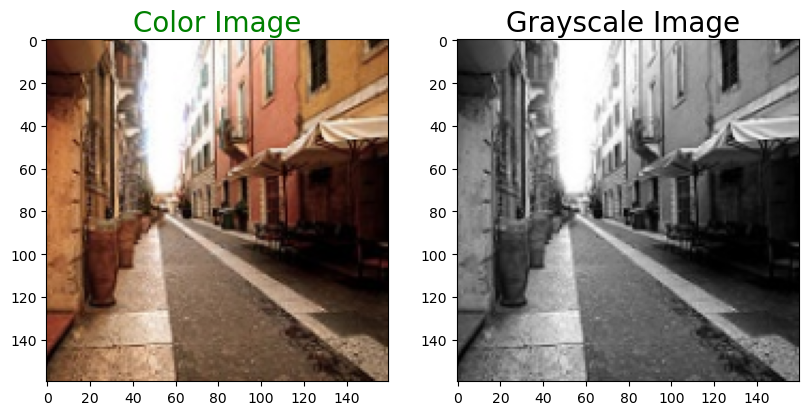

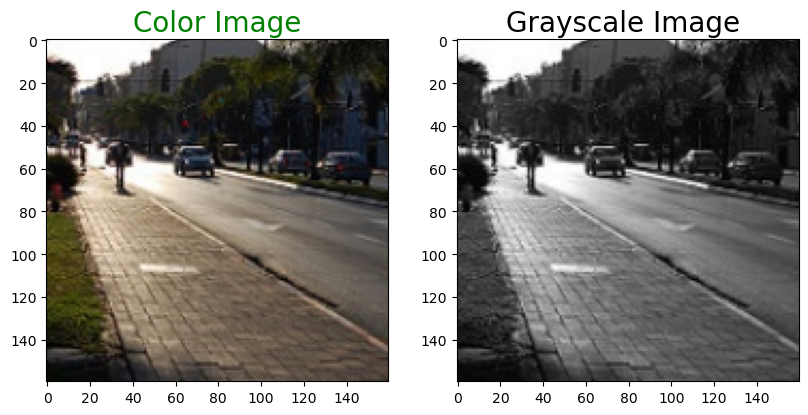

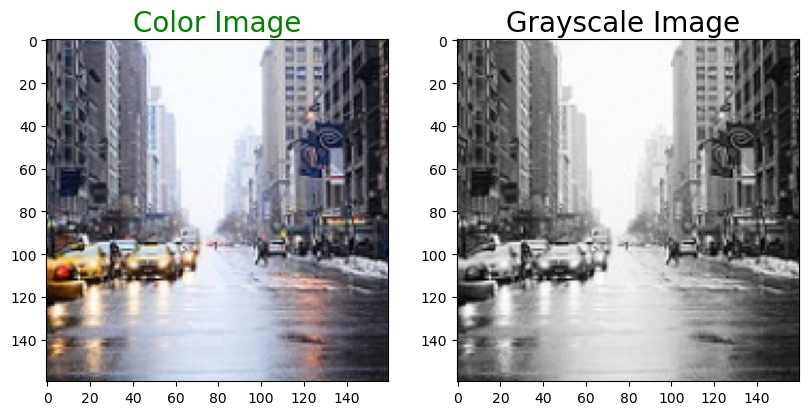

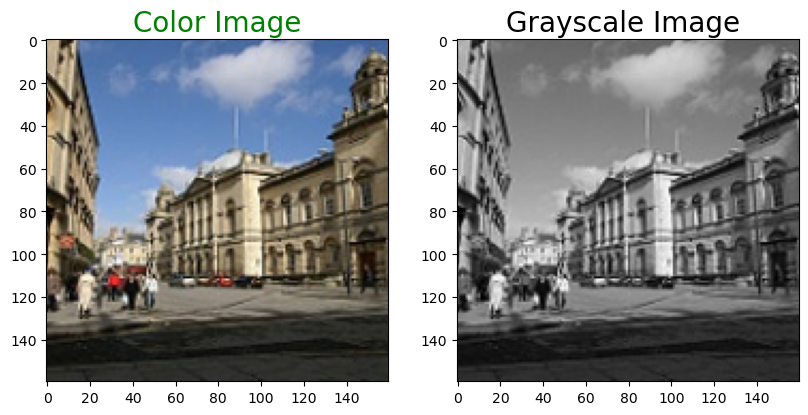

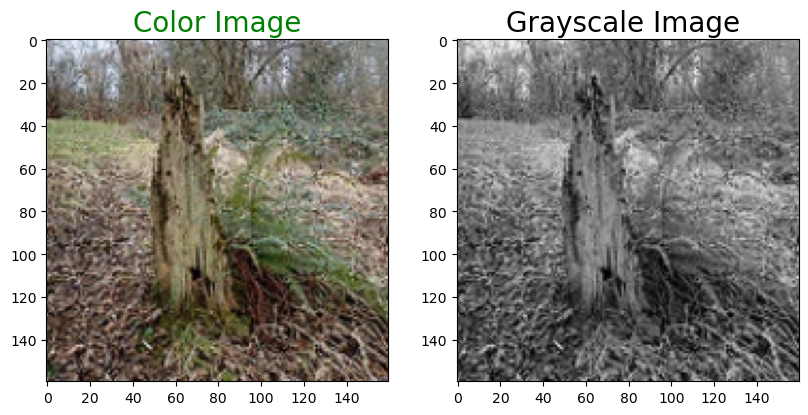

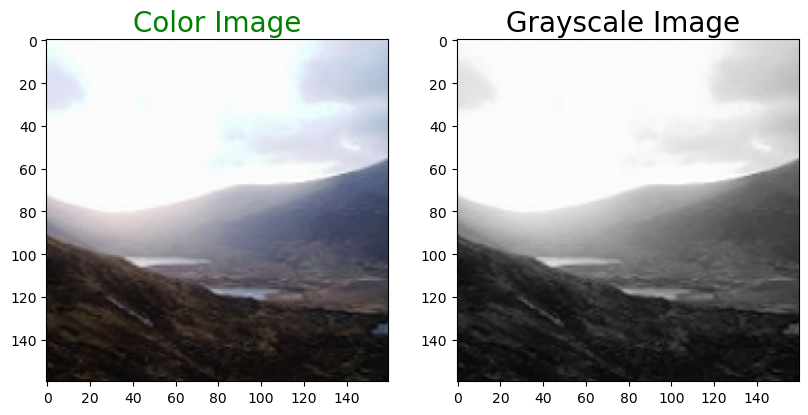

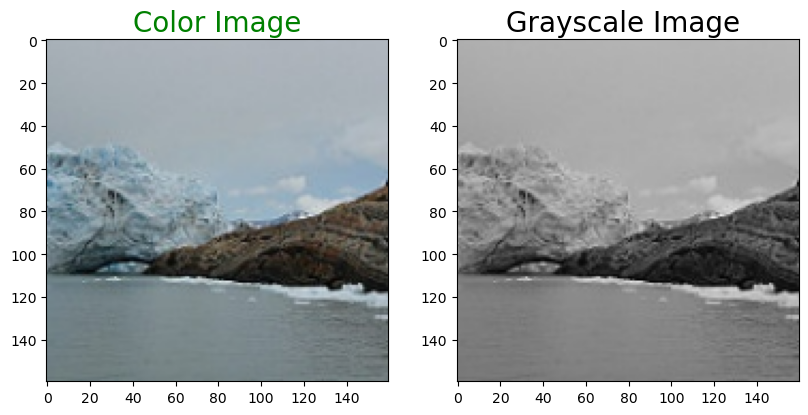

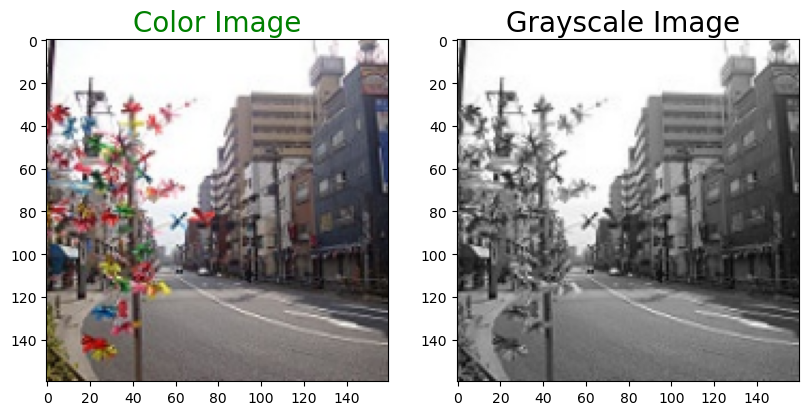

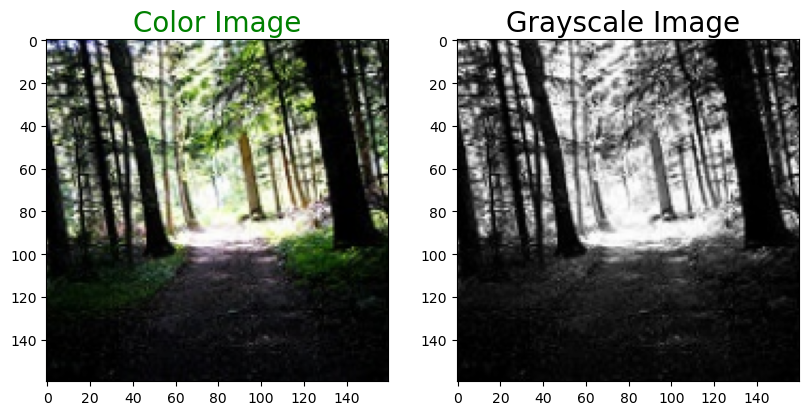

In [3]:
def plot_images(color,grayscale):
    plt.figure(figsize=(15,15))
    plt.subplot(1,3,1)
    plt.title('Color Image', color = 'green', fontsize = 20)
    plt.imshow(color)
    plt.subplot(1,3,2)
    plt.title('Grayscale Image ', color = 'black', fontsize = 20)
    plt.imshow(grayscale)
    plt.show()

for i in range(20,30):
     plot_images(color_img[i],gray_img[i])

In [4]:
# train split 
len_data = len(color_img)
train_size = int(len_data*0.8)

train_gray_image = gray_img[:train_size]
train_color_image = color_img[:train_size]

test_gray_image = gray_img[train_size:]
test_color_image = color_img[train_size:]

train_g = np.reshape(train_gray_image,(len(train_gray_image),SIZE,SIZE,3))
train_c = np.reshape(train_color_image, (len(train_color_image),SIZE,SIZE,3))
print('Train color image shape:',train_c.shape)


test_gray_image = np.reshape(test_gray_image,(len(test_gray_image),SIZE,SIZE,3))
test_color_image = np.reshape(test_color_image, (len(test_color_image),SIZE,SIZE,3))
print('Test color image shape',test_color_image.shape)

Train color image shape: (5703, 160, 160, 3)
Test color image shape (1426, 160, 160, 3)


In [5]:
from AE_RESNET.resnetAE import ResNetAE
from AE_RESNET.resnetAE_mod import ResNetAE_mod

In [6]:
resnet50AEMod = ResNetAE_mod(input_shape=(SIZE,SIZE,3), output_channels=3, resnet_decoder=True,
                              bottleneck_layers=[3,4,6,3],bottleneck_strides=[1,2,2,2], 
                              bottleneck_num_layer=3)
resnet50AEMod.summary()

Model: "ResNetAEMod"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 ResNet_encoder (Functional)    (None, 5, 5, 2048)   23587712    ['input_1[0][0]']                
                                                                                                  
 ResNet_decoder (Functional)    (None, 160, 160, 3)  28838031    ['ResNet_encoder[0][0]']         
                                                                                                  
 concatenate (Concatenate)      (None, 160, 160, 6)  0           ['input_1[0][0]',      

In [7]:
optimizer = keras.optimizers.Adam(learning_rate=0.001)
resnet50AEMod.compile(optimizer=optimizer, loss="mae")

early_stopping = keras.callbacks.EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

history = resnet50AEMod.fit(
    train_g,
    train_c,
    epochs=60,
    batch_size=32, 
    shuffle=True,
    validation_split=0.1, 
    callbacks=[]
    )

Epoch 1/60
161/161 [==============================] - 105s 587ms/step - loss: 0.1478 - val_loss: 0.1244
Epoch 2/60
161/161 [==============================] - 90s 560ms/step - loss: 0.0740 - val_loss: 0.2151
Epoch 3/60
161/161 [==============================] - 90s 561ms/step - loss: 0.0637 - val_loss: 0.1319
Epoch 4/60
161/161 [==============================] - 90s 560ms/step - loss: 0.0602 - val_loss: 0.1073
Epoch 5/60
161/161 [==============================] - 90s 560ms/step - loss: 0.0583 - val_loss: 0.0770
Epoch 6/60
161/161 [==============================] - 90s 560ms/step - loss: 0.0566 - val_loss: 0.0740
Epoch 7/60
161/161 [==============================] - 90s 560ms/step - loss: 0.0557 - val_loss: 0.0764
Epoch 8/60
161/161 [==============================] - 90s 560ms/step - loss: 0.0543 - val_loss: 0.0696
Epoch 9/60
161/161 [==============================] - 90s 560ms/step - loss: 0.0533 - val_loss: 0.0691
Epoch 10/60
161/161 [==============================] - 90s 560ms/step - 

1/1 [==============================] - 1s 1s/step


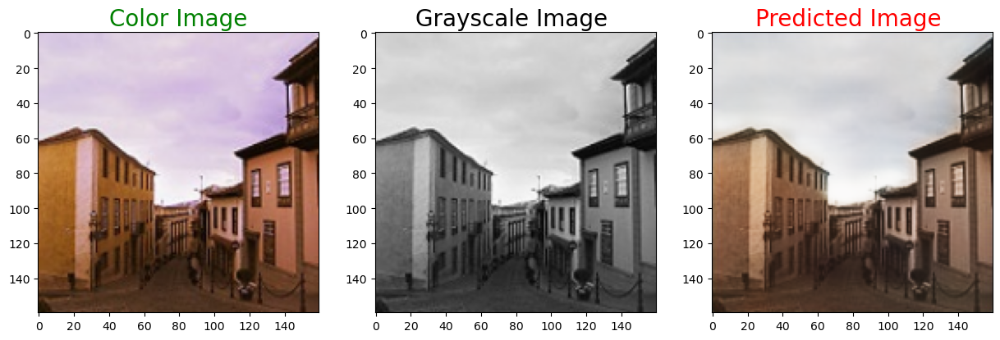

1/1 [==============================] - 0s 17ms/step


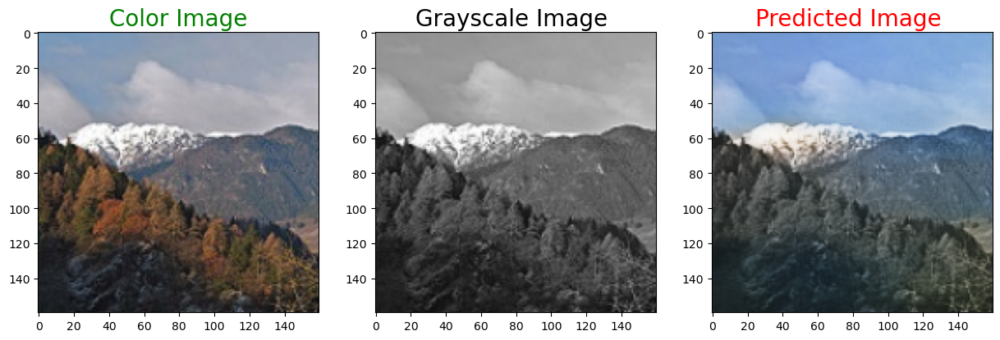

1/1 [==============================] - 0s 16ms/step


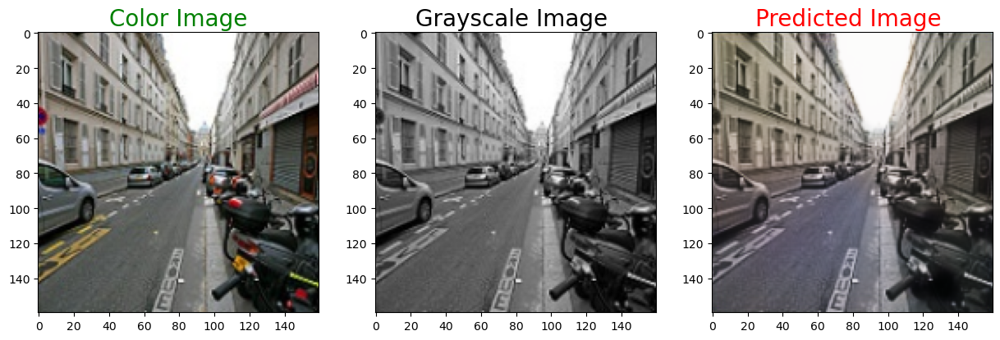

1/1 [==============================] - 0s 17ms/step


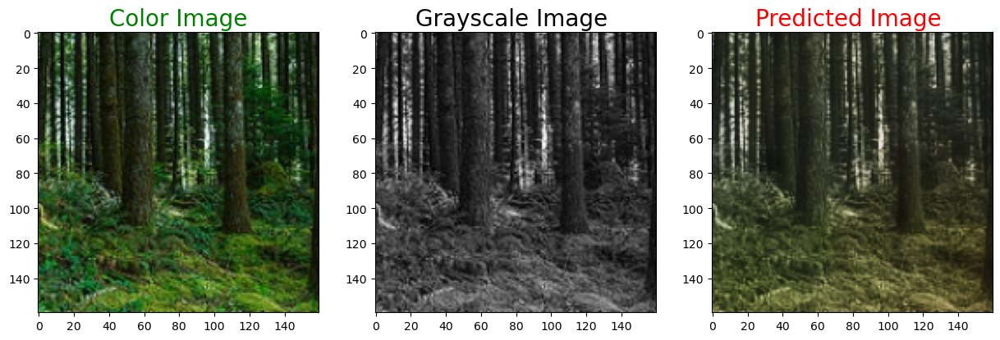

1/1 [==============================] - 0s 17ms/step


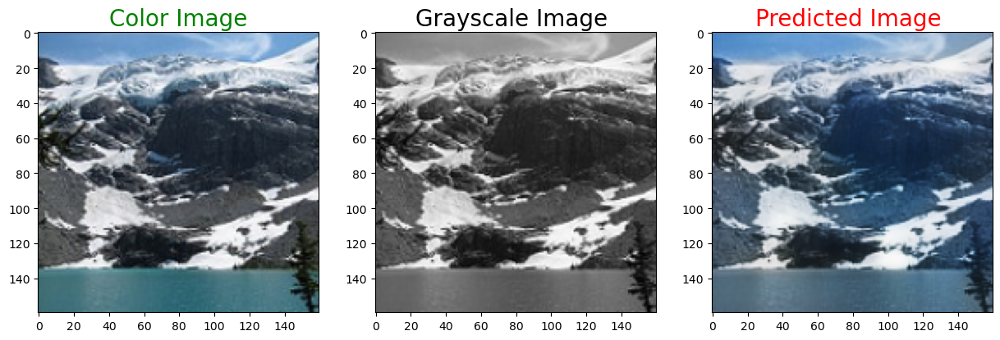

1/1 [==============================] - 0s 17ms/step


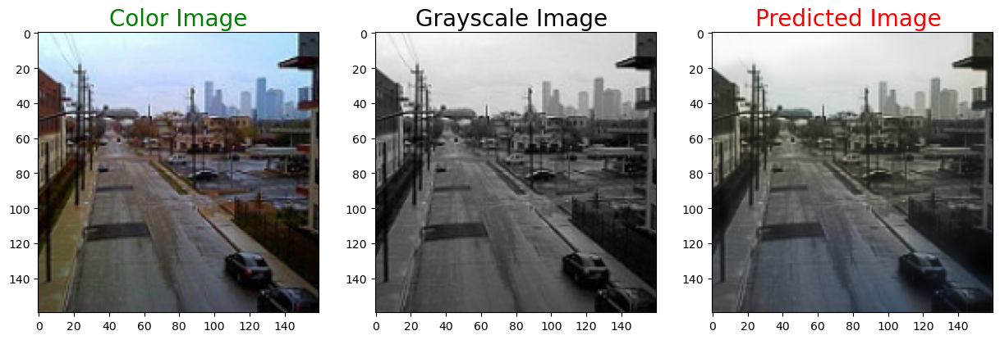

1/1 [==============================] - 0s 16ms/step


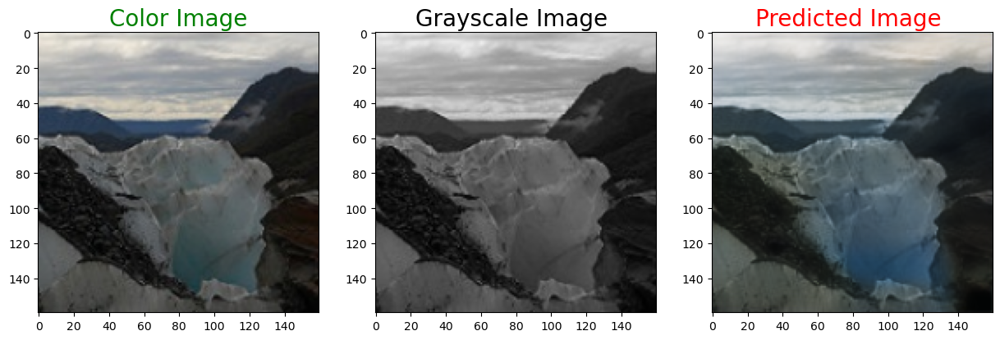

1/1 [==============================] - 0s 16ms/step


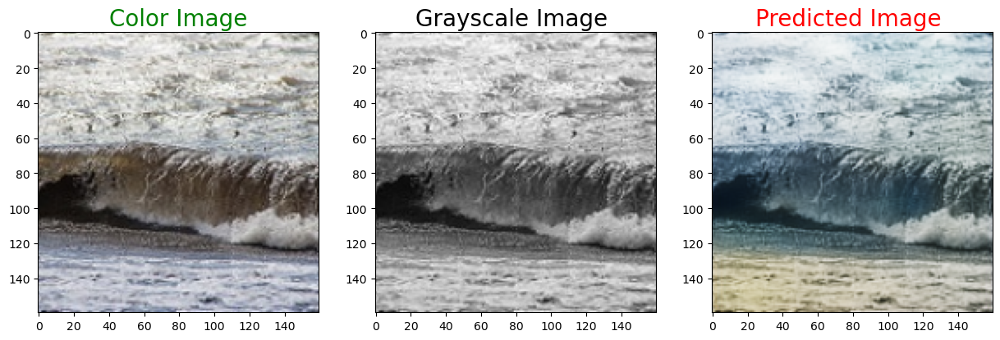

In [8]:
def plot_images(color,grayscale,predicted):
    plt.figure(figsize=(15,15))
    plt.subplot(1,3,1)
    plt.title('Color Image', color = 'green', fontsize = 20)
    plt.imshow(color)
    plt.subplot(1,3,2)
    plt.title('Grayscale Image ', color = 'black', fontsize = 20)
    plt.imshow(grayscale)
    plt.subplot(1,3,3)
    plt.title('Predicted Image ', color = 'Red', fontsize = 20)
    plt.imshow(predicted)
   
    plt.show()

for i in range(75,83):
    predicted = np.clip(resnet50AEMod.predict(test_gray_image[i].reshape(1,SIZE, SIZE,3)),0.0,1.0).reshape(SIZE, SIZE,3)
    plot_images(test_color_image[i],test_gray_image[i],predicted)

1/1 [==============================] - 0s 18ms/step


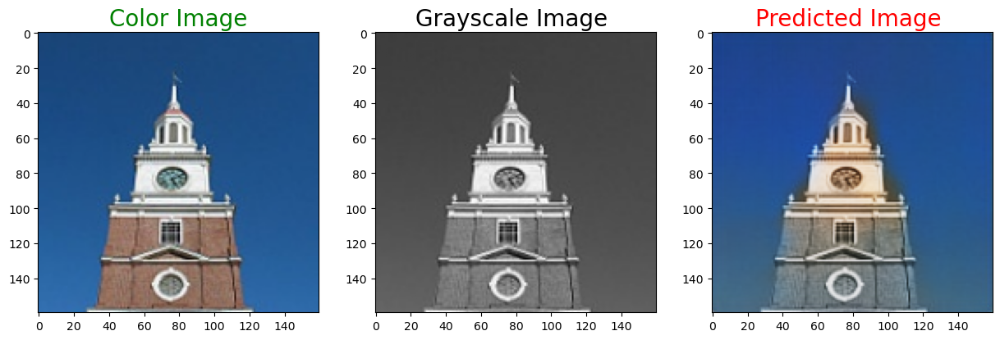

1/1 [==============================] - 0s 16ms/step


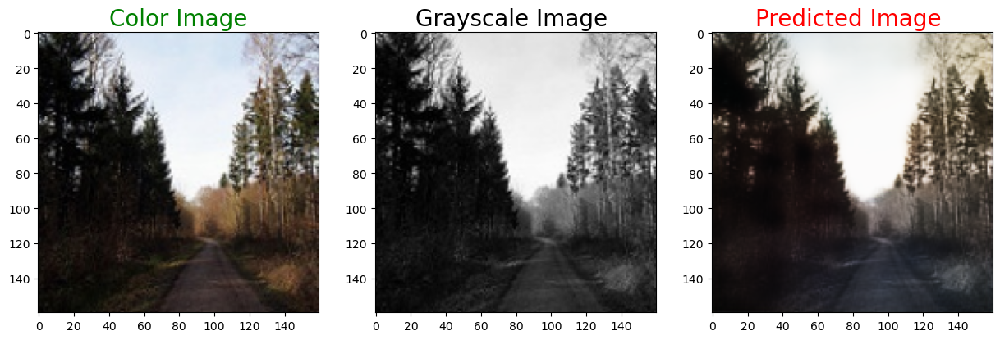

1/1 [==============================] - 0s 17ms/step


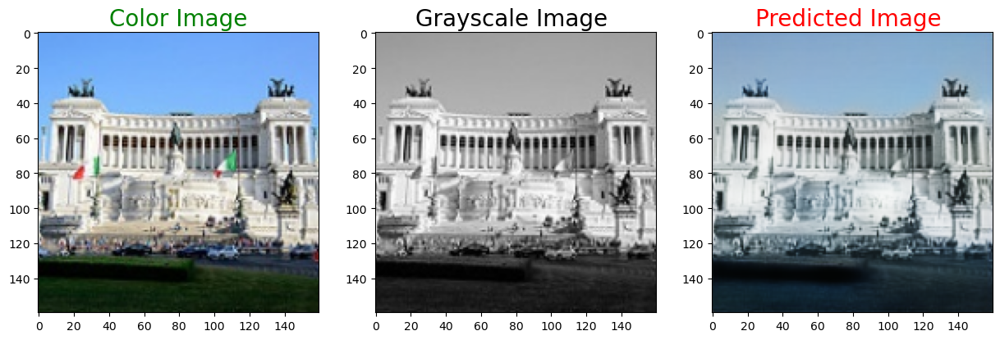

1/1 [==============================] - 0s 16ms/step


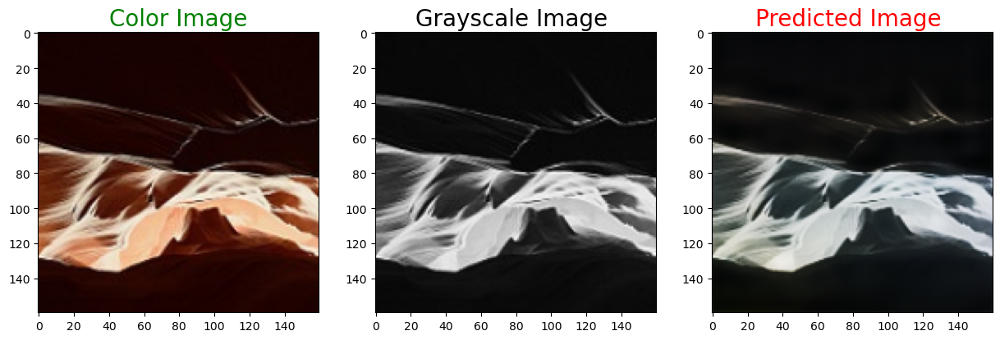

1/1 [==============================] - 0s 18ms/step


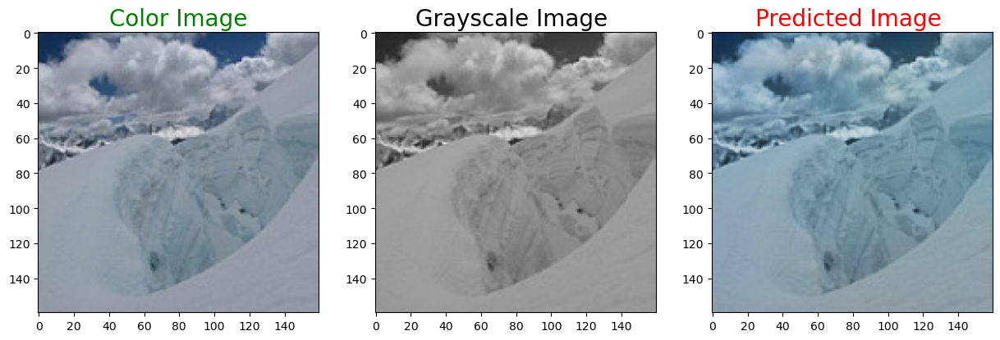

1/1 [==============================] - 0s 17ms/step


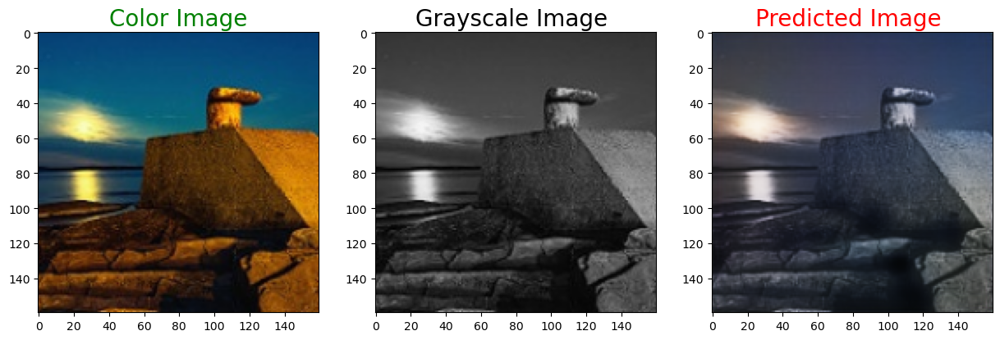

1/1 [==============================] - 0s 17ms/step


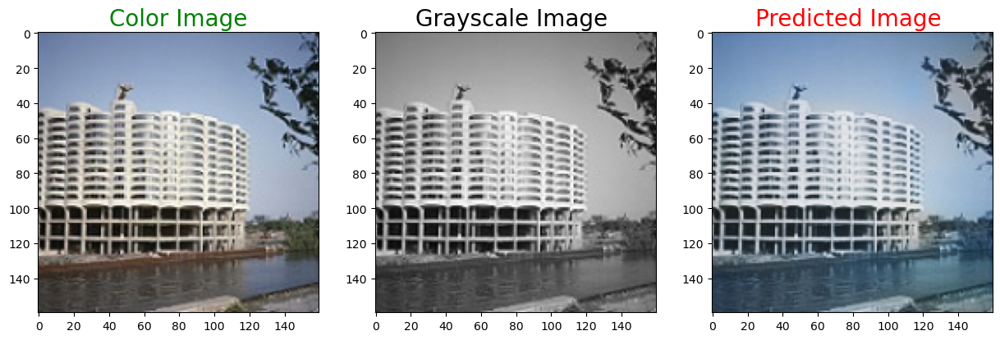

1/1 [==============================] - 0s 17ms/step


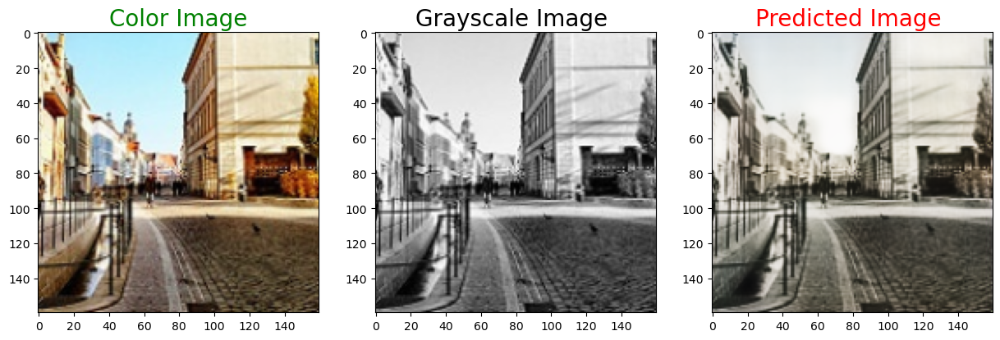

In [9]:
for i in range(500,508):
    predicted = np.clip(resnet50AEMod.predict(test_gray_image[i].reshape(1,SIZE, SIZE,3)),0.0,1.0).reshape(SIZE, SIZE,3)
    plot_images(test_color_image[i],test_gray_image[i],predicted)

In [10]:
resnet50AEMod.save('final_models/resnet50AE_mod_lr001.h5')

In [11]:
predictions = resnet50AEMod.predict(test_gray_image)
test_data_prue = np.squeeze(test_gray_image)
predictions_prue = np.squeeze(predictions)

resnet50AEMod.evaluate(test_data_prue, predictions_prue, channel_axis=-1)

45/45 [==============================] - 8s 171ms/step
SSIM: 0.9732869267463684
PSNR: 24.79796454579347


In [12]:
import matplotlib.pyplot as plt
import numpy as np

def plot_lr(history):
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('Model Loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='upper left')
    plt.show()

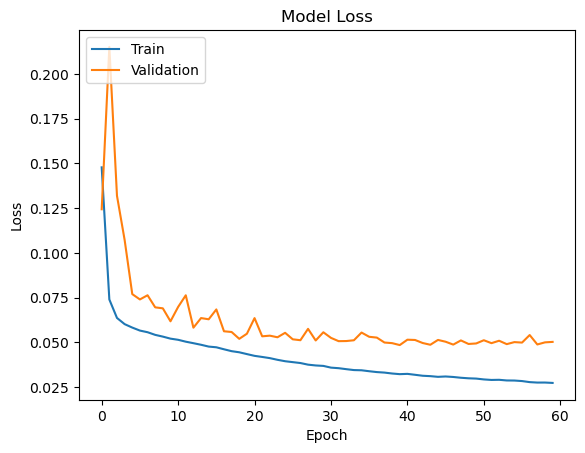

In [13]:
plot_lr(history)

In [14]:
resnet50AE = ResNetAE(input_shape=(SIZE,SIZE,3), output_channels=3, resnet_decoder=True,
                      bottleneck_layers=[3,4,6,3],bottleneck_strides=[1,2,2,2], 
                      bottleneck_num_layer=3)
resnet50AE.summary()

Model: "ResNetAE"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 160, 160, 3)]     0         
                                                                 
 ResNet_encoder (Functional)  (None, 5, 5, 2048)       23587712  
                                                                 
 ResNet_decoder (Functional)  (None, 160, 160, 3)      28838031  
                                                                 
Total params: 52,425,743
Trainable params: 52,319,625
Non-trainable params: 106,118
_________________________________________________________________


In [15]:
optimizer = keras.optimizers.Adam(learning_rate=0.0001)
resnet50AE.compile(optimizer=optimizer, loss="mae")

early_stopping = keras.callbacks.EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

history = resnet50AE.fit(
    train_g,
    train_c,
    epochs=40,
    batch_size=32, 
    shuffle=True,
    validation_split=0.1, 
    callbacks=[]
    )

Epoch 1/40
161/161 [==============================] - 105s 587ms/step - loss: 0.1525 - val_loss: 0.2434
Epoch 2/40
161/161 [==============================] - 90s 559ms/step - loss: 0.1168 - val_loss: 0.1835
Epoch 3/40
161/161 [==============================] - 90s 559ms/step - loss: 0.1087 - val_loss: 0.1129
Epoch 4/40
161/161 [==============================] - 90s 559ms/step - loss: 0.1043 - val_loss: 0.1054
Epoch 5/40
161/161 [==============================] - 90s 559ms/step - loss: 0.1009 - val_loss: 0.0979
Epoch 6/40
161/161 [==============================] - 90s 559ms/step - loss: 0.0984 - val_loss: 0.0977
Epoch 7/40
161/161 [==============================] - 90s 559ms/step - loss: 0.0957 - val_loss: 0.0994
Epoch 8/40
161/161 [==============================] - 90s 559ms/step - loss: 0.0936 - val_loss: 0.1017
Epoch 9/40
161/161 [==============================] - 90s 559ms/step - loss: 0.0912 - val_loss: 0.0962
Epoch 10/40
161/161 [==============================] - 90s 559ms/step - 

1/1 [==============================] - 1s 1s/step


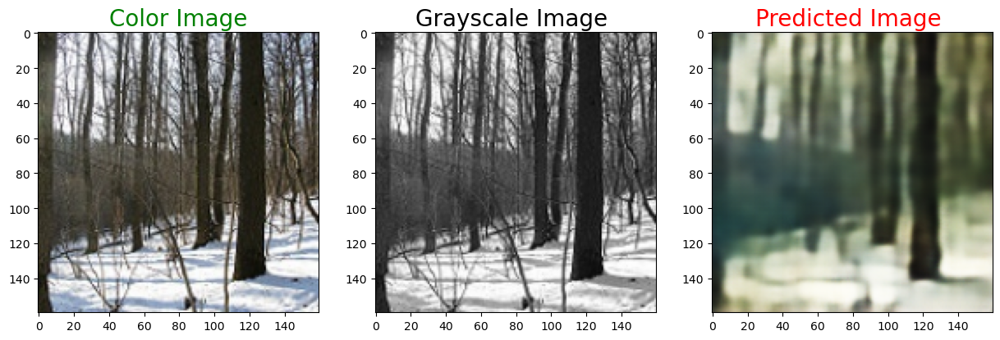

1/1 [==============================] - 0s 15ms/step


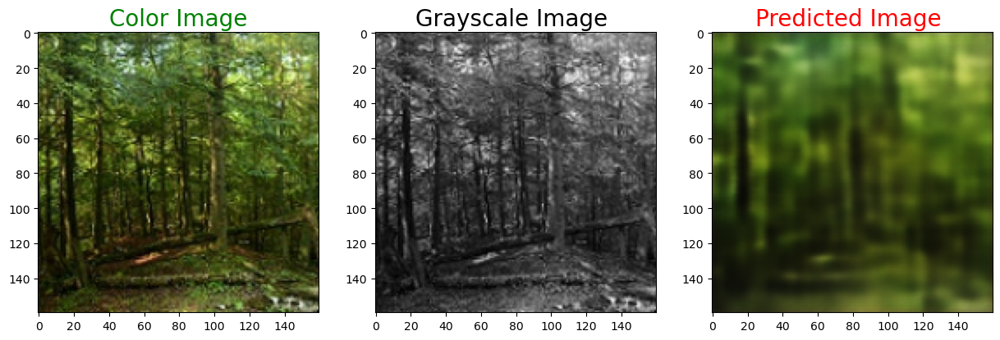

1/1 [==============================] - 0s 17ms/step


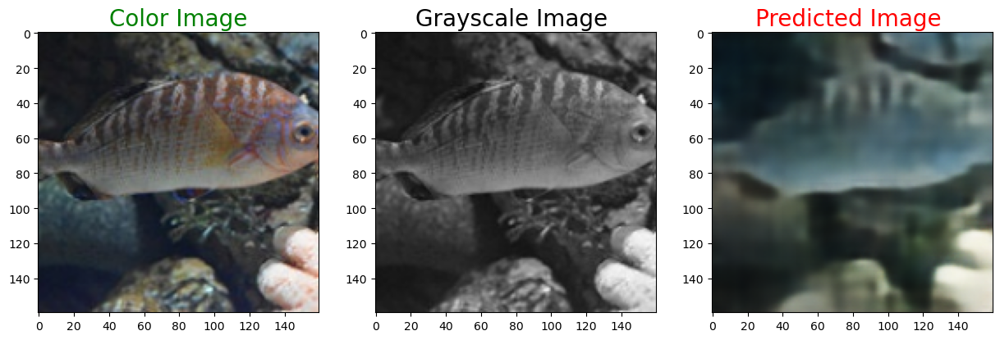

1/1 [==============================] - 0s 18ms/step


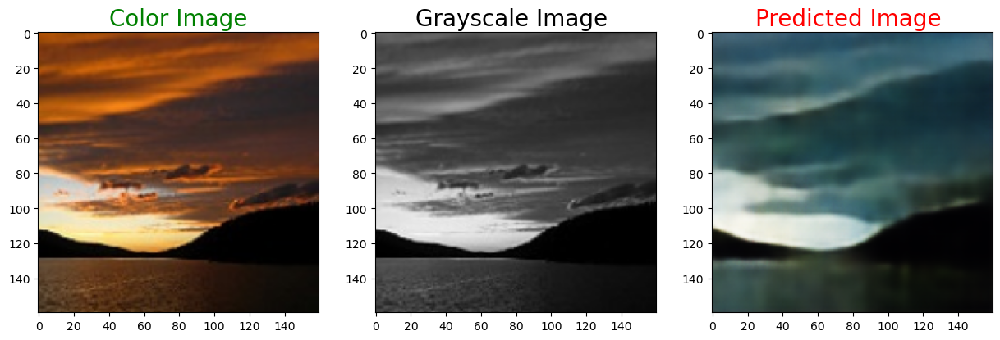

1/1 [==============================] - 0s 18ms/step


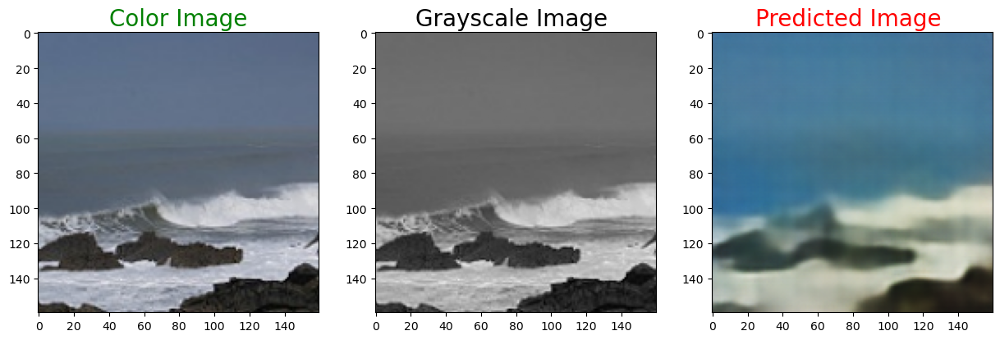

1/1 [==============================] - 0s 17ms/step


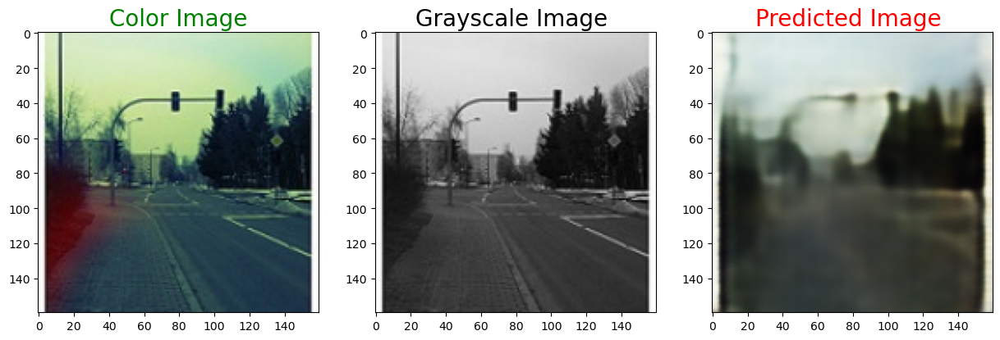

1/1 [==============================] - 0s 16ms/step


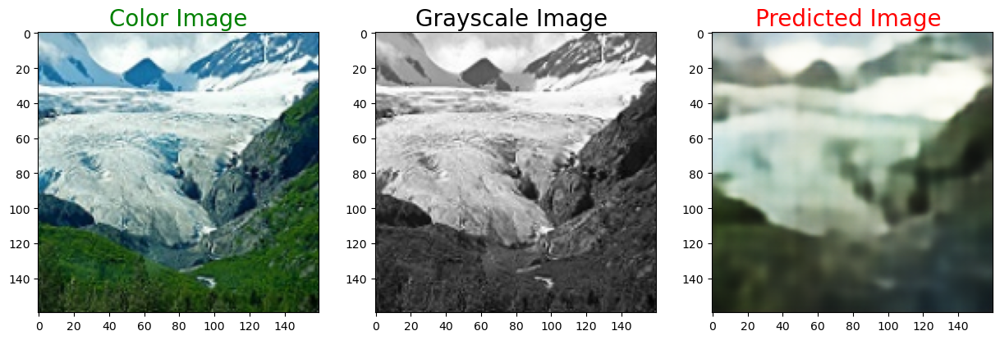

1/1 [==============================] - 0s 17ms/step


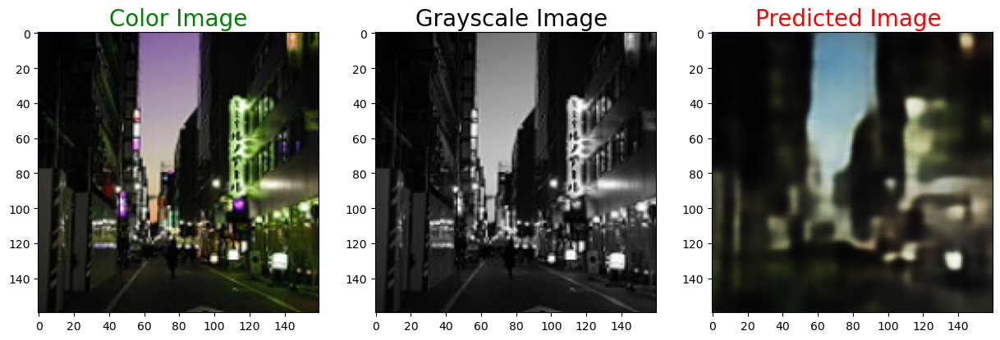

In [16]:
# defining function to plot images pair
def plot_images(color,grayscale,predicted):
    plt.figure(figsize=(15,15))
    plt.subplot(1,3,1)
    plt.title('Color Image', color = 'green', fontsize = 20)
    plt.imshow(color)
    plt.subplot(1,3,2)
    plt.title('Grayscale Image ', color = 'black', fontsize = 20)
    plt.imshow(grayscale)
    plt.subplot(1,3,3)
    plt.title('Predicted Image ', color = 'Red', fontsize = 20)
    plt.imshow(predicted)
   
    plt.show()

for i in range(50,58):
    predicted = np.clip(resnet50AE.predict(test_gray_image[i].reshape(1,SIZE, SIZE,3)),0.0,1.0).reshape(SIZE, SIZE,3)
    plot_images(test_color_image[i],test_gray_image[i],predicted)

1/1 [==============================] - 0s 15ms/step


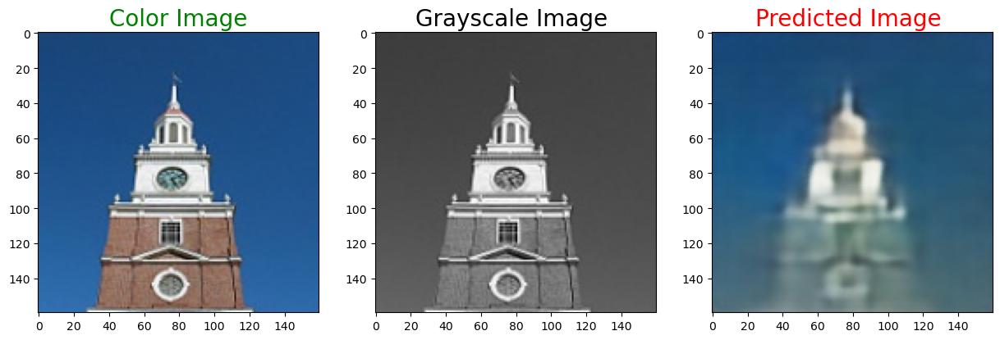

1/1 [==============================] - 0s 16ms/step


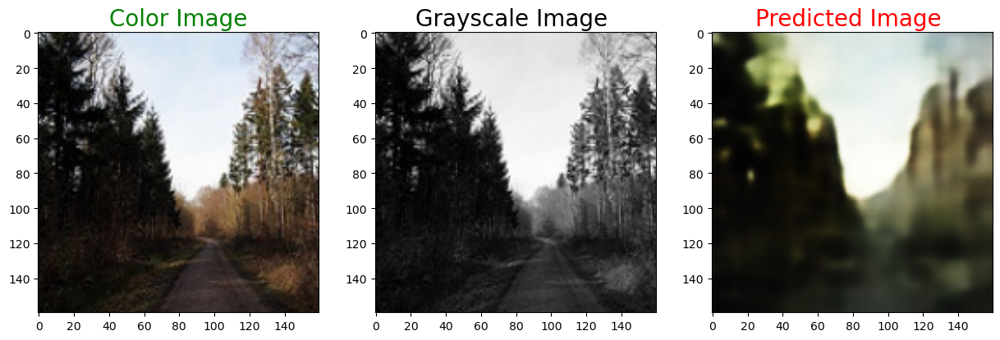

1/1 [==============================] - 0s 16ms/step


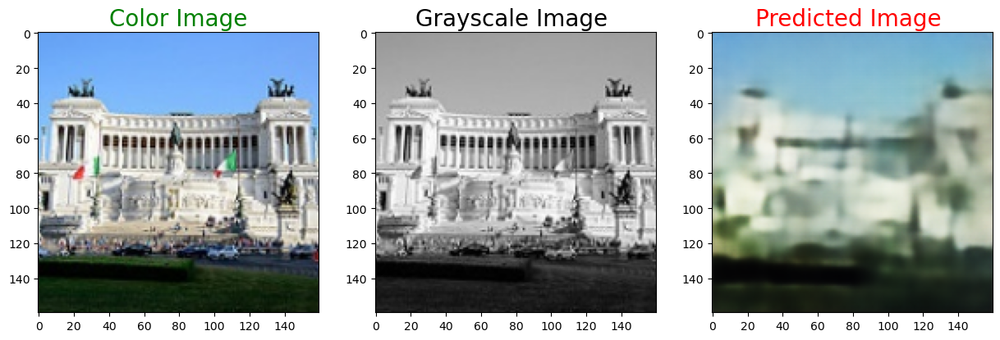

1/1 [==============================] - 0s 16ms/step


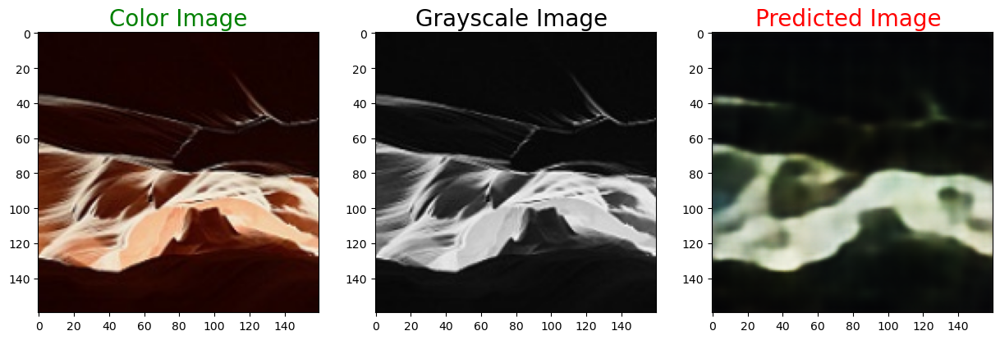

1/1 [==============================] - 0s 28ms/step


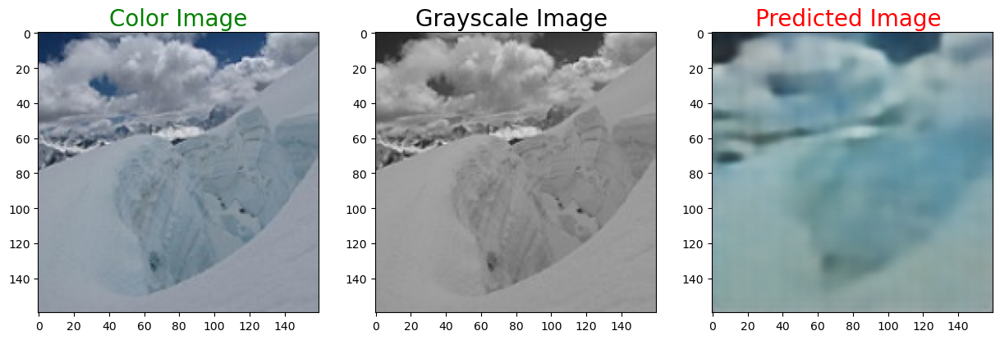

1/1 [==============================] - 0s 16ms/step


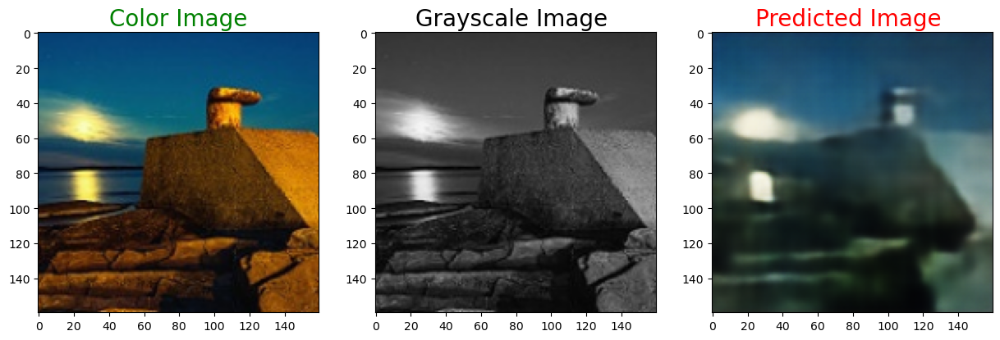

1/1 [==============================] - 0s 16ms/step


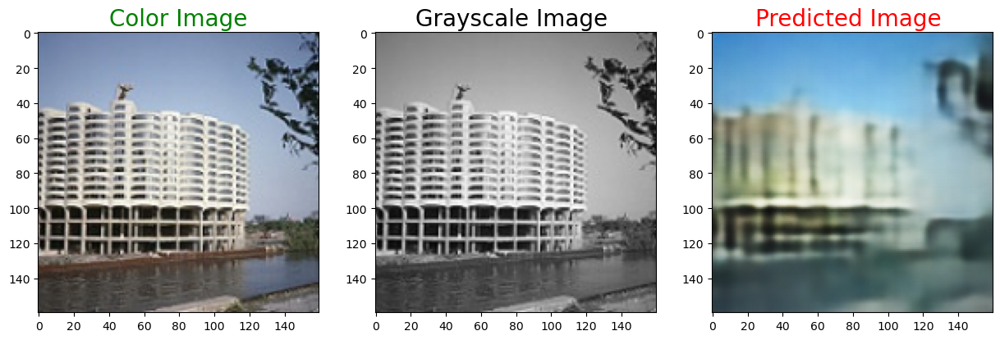

1/1 [==============================] - 0s 19ms/step


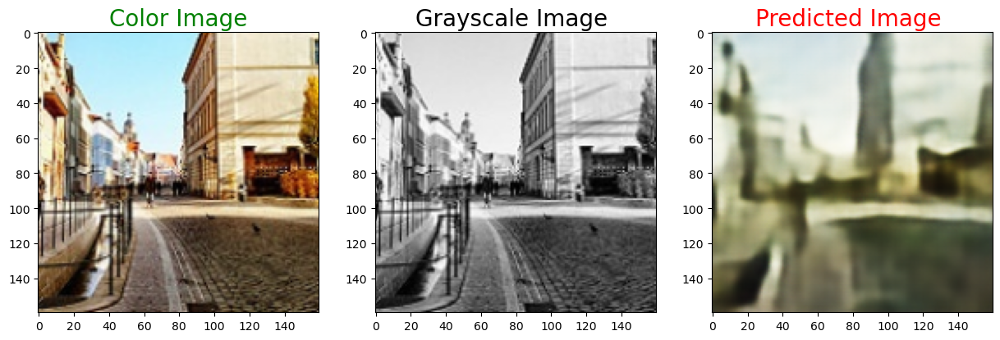

In [17]:
for i in range(500,508):
    predicted = np.clip(resnet50AE.predict(test_gray_image[i].reshape(1,SIZE, SIZE,3)),0.0,1.0).reshape(SIZE, SIZE,3)
    plot_images(test_color_image[i],test_gray_image[i],predicted)

In [18]:
predictions = resnet50AE.predict(test_gray_image)
test_data_prue = np.squeeze(test_gray_image)
predictions_prue = np.squeeze(predictions)

45/45 [==============================] - 8s 170ms/step


In [19]:
resnet50AE.evaluate(test_data_prue, predictions_prue, channel_axis=-1)

SSIM: 0.8718178868293762
PSNR: 19.24862744243468


In [20]:
resnet50AE.save('final_models/resnet50AE_lr0001.h5')

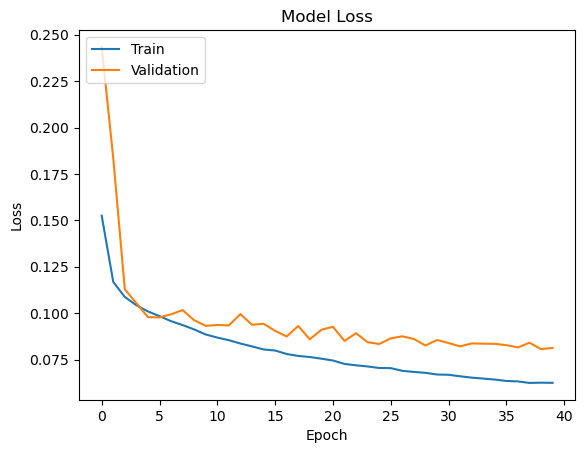

In [23]:
plot_lr(history)